In [48]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
!pip install -U pandasql

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [49]:
import plotly.express as px
import plotly.graph_objects as go
from pandasql import sqldf
import datetime 
from pandas._libs.tslibs.timedeltas import parse_timedelta_unit
import xlrd
from plotly.subplots import make_subplots

In [50]:
#read dataset into dataframe
cab_df=pd.read_csv("https://raw.githubusercontent.com/DataGlacier/DataSets/main/Cab_Data.csv")
cab_df.head()

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip
0,10000011,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.635
1,10000012,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.854
2,10000013,42371,Pink Cab,ATLANTA GA,9.04,125.20,97.632
3,10000014,42376,Pink Cab,ATLANTA GA,33.17,377.40,351.602
4,10000015,42372,Pink Cab,ATLANTA GA,8.73,114.62,97.776


In [51]:
print(cab_df.shape)
print(cab_df.dtypes)

(359392, 7)
Transaction ID      int64
Date of Travel      int64
Company            object
City               object
KM Travelled      float64
Price Charged     float64
Cost of Trip      float64
dtype: object


In [52]:
#convert date of travel to date format
travel_date=[] #create an empty list
for n in cab_df['Date of Travel']: 
  # Initializing an excel serial date
  xl_date = n  
  # Calling the xldate_as_datetime() function to
  # convert the specified excel serial date into
  # datetime.datetime object
  datetime_date = xlrd.xldate_as_datetime(xl_date, 0)    
  # Calling the datetime_date.date() function to convert
  # the above returned datetime.datetime object into
  # datetime.date object
  date_object = datetime_date.date()
    
  # Calling the isoformat() function to convert the date_object to string
  string_date = date_object.isoformat()
  #append the str to travel_date list
  travel_date.append(string_date)  

In [53]:
# append travel_date to the dataframe
cab_df['travel_date_']=travel_date
cab_df.head()

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,travel_date_
0,10000011,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.635,2016-01-08
1,10000012,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.854,2016-01-06
2,10000013,42371,Pink Cab,ATLANTA GA,9.04,125.20,97.632,2016-01-02
3,10000014,42376,Pink Cab,ATLANTA GA,33.17,377.40,351.602,2016-01-07
4,10000015,42372,Pink Cab,ATLANTA GA,8.73,114.62,97.776,2016-01-03


In [54]:
#drop date with xlrd format
cab_df.drop(['Date of Travel'], axis=1, inplace=True)
#rename columns
cab_df.columns = cab_df.columns.str.replace(' ', '_')
cab_df.head()

,Transaction_ID,Company,City,KM_Travelled,Price_Charged,Cost_of_Trip,travel_date_
0,10000011,Pink Cab,ATLANTA GA,30.45,370.95,313.635,2016-01-08
1,10000012,Pink Cab,ATLANTA GA,28.62,358.52,334.854,2016-01-06
2,10000013,Pink Cab,ATLANTA GA,9.04,125.20,97.632,2016-01-02
3,10000014,Pink Cab,ATLANTA GA,33.17,377.40,351.602,2016-01-07
4,10000015,Pink Cab,ATLANTA GA,8.73,114.62,97.776,2016-01-03


In [55]:
#convert date format to datetime like
cab_df['travel_date_'] = pd.to_datetime(cab_df['travel_date_'], format='%Y-%m-%d')

In [56]:
#load transaction dataset
transaction_df=pd.read_csv("https://raw.githubusercontent.com/DataGlacier/DataSets/main/Transaction_ID.csv")
#replace columns
transaction_df.columns = transaction_df.columns.str.replace(' ', '_')
transaction_df.head()

,Transaction_ID,Customer_ID,Payment_Mode
0,10000011,29290,Card
1,10000012,27703,Card
2,10000013,28712,Cash
3,10000014,28020,Cash
4,10000015,27182,Card


In [57]:
#load customer ID dataset
customer_df=pd.read_csv("https://raw.githubusercontent.com/DataGlacier/DataSets/main/Customer_ID.csv")
customer_df.columns = customer_df.columns.str.replace(' ', '_')
print(customer_df.dtypes)
customer_df.head()

Customer_ID            int64
Gender                object
Age                    int64
Income_(USD/Month)     int64
dtype: object


,Customer_ID,Gender,Age,Income_(USD/Month)
0,29290,Male,28,10813
1,27703,Male,27,9237
2,28712,Male,53,11242
3,28020,Male,23,23327
4,27182,Male,33,8536


In [58]:
#load city dataset
city_df=pd.read_csv('https://raw.githubusercontent.com/DataGlacier/DataSets/main/City.csv')
city_df.dtypes

City          object
Population    object
Users         object
dtype: object

In [59]:
#change data type for population and users, it should be integers
city_df['Users'] = city_df['Users'].str.replace(',', '').astype(float)
city_df['Population'] = city_df['Population'].str.replace(',', '').astype(float)
print(city_df.dtypes)
city_df.head()

City           object
Population    float64
Users         float64
dtype: object


,City,Population,Users
0,NEW YORK NY,8405837.0,302149.0
1,CHICAGO IL,1955130.0,164468.0
2,LOS ANGELES CA,1595037.0,144132.0
3,MIAMI FL,1339155.0,17675.0
4,SILICON VALLEY,1177609.0,27247.0


In [60]:
#load us holiday dataset
holiday_df=pd.read_csv("https://raw.githubusercontent.com/MaharazAliyu/G2M-Cab-Market-Analysis/main/US%20Holiday%20Dates%20(2004-2021).csv")
print(holiday_df.dtypes)
holiday_df.head()

Date       object
Holiday    object
WeekDay    object
Month       int64
Day         int64
Year        int64
dtype: object


,Date,Holiday,WeekDay,Month,Day,Year
0,2004-07-04,4th of July,Sunday,7,4,2004
1,2005-07-04,4th of July,Monday,7,4,2005
2,2006-07-04,4th of July,Tuesday,7,4,2006
3,2007-07-04,4th of July,Wednesday,7,4,2007
4,2008-07-04,4th of July,Friday,7,4,2008


To join dataframes to make a master dataframe
we will use pandasql library instead of connecting to database server

In [61]:
q="""SELECT cab_df.*, customer_df.*, transaction_df.Payment_Mode, city_df.Population, city_df.Users FROM cab_df
INNER JOIN transaction_df ON transaction_df.Transaction_ID = cab_df.Transaction_ID 
INNER JOIN customer_df ON customer_df.Customer_ID = transaction_df.Customer_ID 
INNER JOIN city_df ON city_df.City = cab_df.City 
ORDER BY Cab_df.Transaction_ID ASC;"""
master_df=sqldf(q, globals())
master_df.head()

,Transaction_ID,Company,City,KM_Travelled,Price_Charged,Cost_of_Trip,travel_date_,Customer_ID,Gender,Age,Income_(USD/Month),Payment_Mode,Population,Users
0,10000011,Pink Cab,ATLANTA GA,30.45,370.95,313.635,2016-01-08 00:00:00.000000,29290,Male,28,10813,Card,814885.0,24701.0
1,10000012,Pink Cab,ATLANTA GA,28.62,358.52,334.854,2016-01-06 00:00:00.000000,27703,Male,27,9237,Card,814885.0,24701.0
2,10000013,Pink Cab,ATLANTA GA,9.04,125.20,97.632,2016-01-02 00:00:00.000000,28712,Male,53,11242,Cash,814885.0,24701.0
3,10000014,Pink Cab,ATLANTA GA,33.17,377.40,351.602,2016-01-07 00:00:00.000000,28020,Male,23,23327,Cash,814885.0,24701.0
4,10000015,Pink Cab,ATLANTA GA,8.73,114.62,97.776,2016-01-03 00:00:00.000000,27182,Male,33,8536,Card,814885.0,24701.0


In [116]:
master_df.shape

(359392, 19)

### EDA:
Check for missing values

In [62]:
#check for missing values
print(" \nCount total NaN at each column in a master_df : \n\n",
      master_df.isnull().sum())

 
Count total NaN at each column in a master_df : 

 Transaction_ID        0
Company               0
City                  0
KM_Travelled          0
Price_Charged         0
Cost_of_Trip          0
travel_date_          0
Customer_ID           0
Gender                0
Age                   0
Income_(USD/Month)    0
Payment_Mode          0
Population            0
Users                 0
dtype: int64


Descriptive Analysis:

In [63]:
master_df.describe()

,Transaction_ID,KM_Travelled,Price_Charged,Cost_of_Trip,Customer_ID,Age,Income_(USD/Month),Population,Users
count,3.593920e+05,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,3.593920e+05,359392.000000
mean,1.022076e+07,22.567254,423.443311,286.190113,19191.652115,35.336705,15048.822937,3.132198e+06,158365.582267
std,1.268058e+05,12.233526,274.378911,157.993661,21012.412463,12.594234,7969.409482,3.315194e+06,100850.051020
min,1.000001e+07,1.900000,15.600000,19.000000,1.000000,18.000000,2000.000000,2.489680e+05,3643.000000
25%,1.011081e+07,12.000000,206.437500,151.200000,2705.000000,25.000000,8424.000000,6.712380e+05,80021.000000
50%,1.022104e+07,22.440000,386.360000,282.480000,7459.000000,33.000000,14685.000000,1.595037e+06,144132.000000
75%,1.033094e+07,32.960000,583.660000,413.683200,36078.000000,42.000000,21035.000000,8.405837e+06,302149.000000
max,1.044011e+07,48.000000,2048.030000,691.200000,60000.000000,65.000000,35000.000000,8.405837e+06,302149.000000


In [64]:
#check correlation
corr_data=master_df.corr()
corr_data

,Transaction_ID,KM_Travelled,Price_Charged,Cost_of_Trip,Customer_ID,Age,Income_(USD/Month),Population,Users
Transaction_ID,1.000000,-0.001429,-0.052902,-0.003462,-0.016912,-0.001267,-0.001570,0.023868,0.013526
KM_Travelled,-0.001429,1.000000,0.835753,0.981848,0.000389,-0.000369,-0.000544,-0.002311,-0.000428
Price_Charged,-0.052902,0.835753,1.000000,0.859812,-0.177324,-0.003084,0.003228,0.326589,0.281061
Cost_of_Trip,-0.003462,0.981848,0.859812,1.000000,0.003077,-0.000189,-0.000633,0.015108,0.023628
Customer_ID,-0.016912,0.000389,-0.177324,0.003077,1.000000,-0.004735,-0.013608,-0.647052,-0.610742
Age,-0.001267,-0.000369,-0.003084,-0.000189,-0.004735,1.000000,0.003907,-0.009002,-0.005906
Income_(USD/Month),-0.001570,-0.000544,0.003228,-0.000633,-0.013608,0.003907,1.000000,0.011868,0.010464
Population,0.023868,-0.002311,0.326589,0.015108,-0.647052,-0.009002,0.011868,1.000000,0.915490
Users,0.013526,-0.000428,0.281061,0.023628,-0.610742,-0.005906,0.010464,0.915490,1.000000


In [65]:
fig = px.imshow(corr_data, text_auto=True, aspect="auto")
fig.show()

In [66]:
'''# Use piechart to see company with higher market income)
fig, (ax1, ax2) = plt.subplots(1,2)
fig.suptitle('Initial Pokemon - 1st Generation')

ax1.pie(master_df['Users'], labels=master_df['City'], autopct='%1.1f%%')
#ax1.set_title('Income Chart')

ax2.pie(master_df['Users'], labels=master_df['Company'],autopct='%1.1f%%')
#ax2.set_title('Users Chart')'''

"# Use piechart to see company with higher market income)\nfig, (ax1, ax2) = plt.subplots(1,2)\nfig.suptitle('Initial Pokemon - 1st Generation')\n\nax1.pie(master_df['Users'], labels=master_df['City'], autopct='%1.1f%%')\n#ax1.set_title('Income Chart')\n\nax2.pie(master_df['Users'], labels=master_df['Company'],autopct='%1.1f%%')\n#ax2.set_title('Users Chart')"

In [67]:
master_df.dtypes
master_df['travel_date_'] = pd.to_datetime(master_df['travel_date_'], format='%Y-%m-%d')#convert travel date to datetimelike

In [68]:
#Calculate monthly sales report
master_df['month_year'] = master_df['travel_date_'].dt.to_period('M')
monthly_sales=master_df.groupby([master_df.month_year, master_df.Company])['Price_Charged'].sum().reset_index()


Text(0, 0.5, 'Cumulative Monthly Revenue')

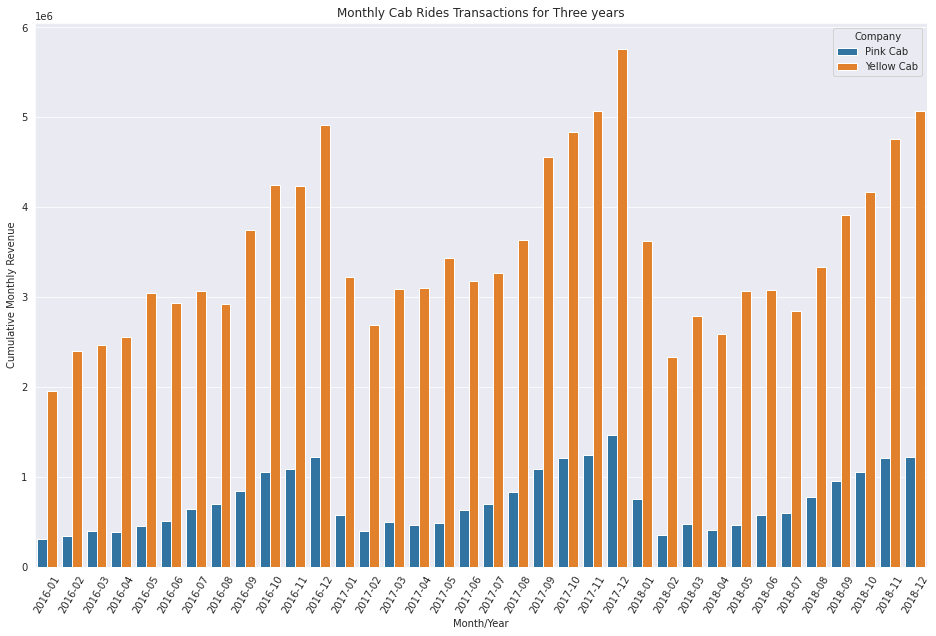

In [69]:
plt.figure(figsize=(16,10))
sns.barplot(data=monthly_sales, x='month_year', y='Price_Charged', hue='Company')
plt.xticks(rotation=60 )
plt.title('Monthly Cab Rides Transactions for Three years')
plt.xlabel('Month/Year')
plt.ylabel('Cumulative Monthly Revenue')

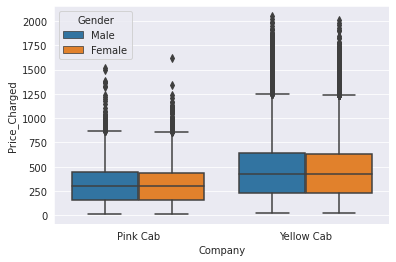

In [70]:
#Outliers
sns.boxplot(data=master_df, x='Company', y='Price_Charged', hue='Gender')

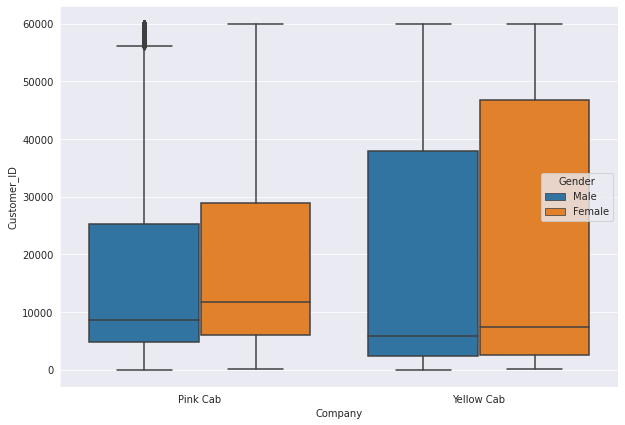

In [71]:
plt.figure(figsize=(10,7))
sns.boxplot(data=master_df, x='Company', y='Customer_ID', hue='Gender')
plt.show()

Hypothesis Question?
1. Does Season affect rate at which customers take taxi?
2. Does company with higher card payment method get more customers?
3. Do gender play a part in customer-cab preferability?
4. What type of customers should company focus more on (short or long distance)?

In [72]:
### HYPOTHESIS 1
#Categorize every transaction to seasonality
#Exctract month and create a different dataframe Month from a master_df
master_df['Year'] = master_df['travel_date_'].dt.year
master_df['Month'] = pd.DatetimeIndex(master_df['travel_date_']).month
season_dict = {1: 'Winter',
               2: 'Winter',
               3: 'Spring', 
               4: 'Spring',
               5: 'Spring',
               6: 'Summer',
               7: 'Summer',
               8: 'Summer',
               9: 'Fall',
               10: 'Fall',
               11: 'Fall',
               12: 'Winter'}
master_df['Season'] = master_df['Month'].apply(lambda x: season_dict[x])

Text(0, 0.5, 'Frequency')

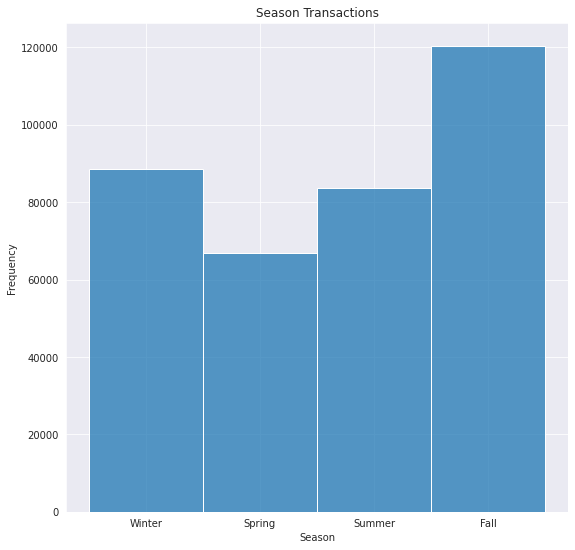

In [73]:
plt.figure(figsize=(9,9))
sns.histplot(data=master_df, x='Season')
plt.title('Season Transactions')
plt.xlabel('Season')
plt.ylabel('Frequency')

Text(0, 0.5, 'Frequency')

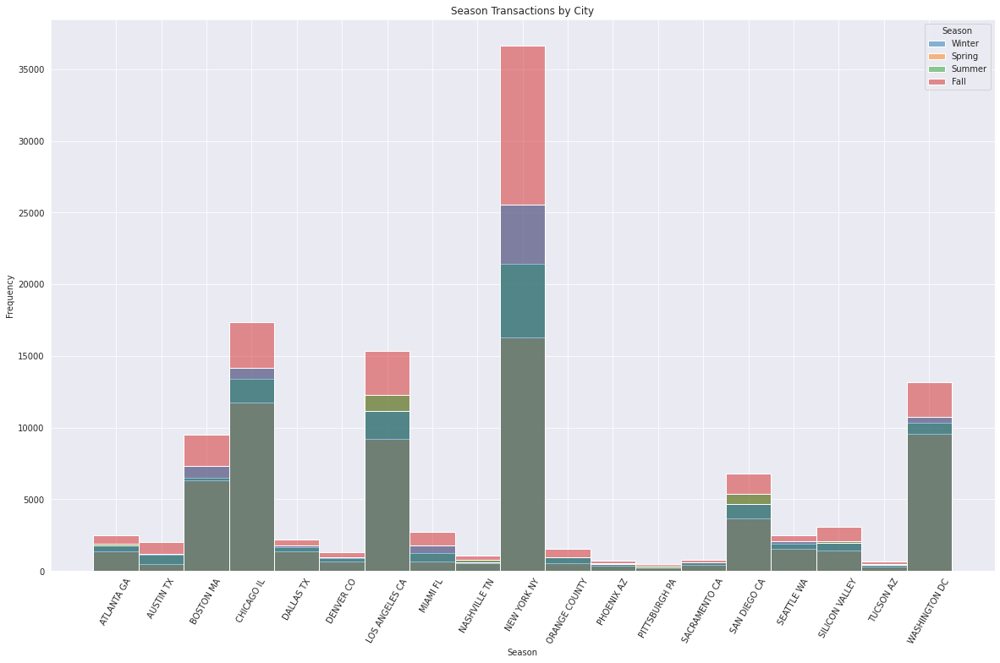

In [74]:
#Analyze the distribution of cab fares in each city by season.
plt.figure(figsize=(20,12))
sns.histplot(data=master_df, x='City', hue='Season')
plt.title('Season Transactions by City')
plt.xlabel('Season')
plt.xticks(rotation = 60)
plt.ylabel('Frequency')

We can see in every city Fall has the highest sales. Mostly followed by summer. Now we analyze seasonal Transactions in each cab company.

Text(0.5, 1.0, 'Yellow Cab Season Transactions')

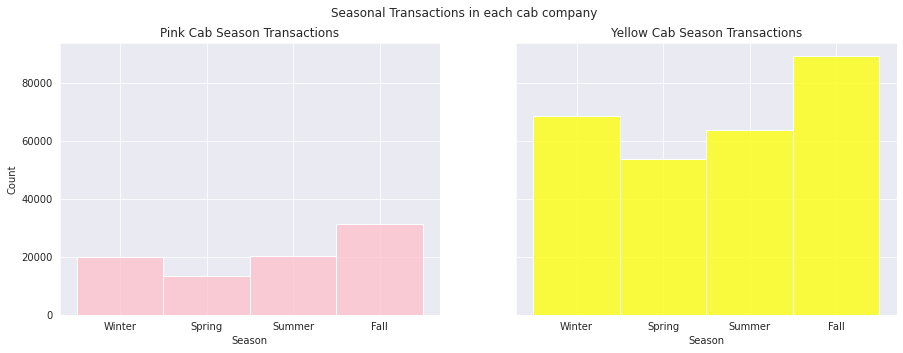

In [75]:
fig, axes = plt.subplots(1, 2, figsize=(15, 5), sharey=True)
sns.set_style("darkgrid")
fig.suptitle('Seasonal Transactions in each cab company')
sns.histplot(ax=axes[0], data=master_df[master_df.Company=='Pink Cab'], x='Season', color='pink')
axes[0].set_title('Pink Cab Season Transactions')
sns.histplot(ax=axes[1], data=master_df[master_df.Company=='Yellow Cab'], x='Season', color='yellow')
axes[1].set_title('Yellow Cab Season Transactions')


As suspected for both companies make more sales during fall season. Nowm, examine which city makes more sales for each company (mostly likely in the fall season).

Text(0, 0.5, 'Frequency')

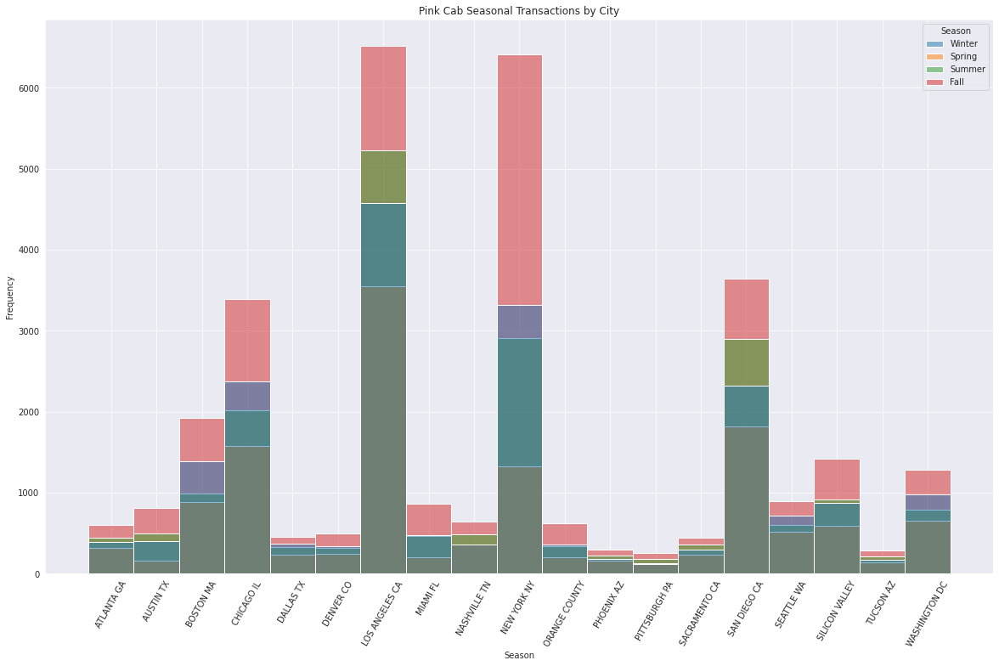

In [76]:
#Pink Cab Plot
plt.figure(figsize=(20,12))
sns.histplot(data=master_df[master_df.Company=='Pink Cab'], x='City', hue='Season')
plt.title('Pink Cab Seasonal Transactions by City')
plt.xlabel('Season')
plt.xticks(rotation = 60)
plt.ylabel('Frequency')

Text(0, 0.5, 'Frequency')

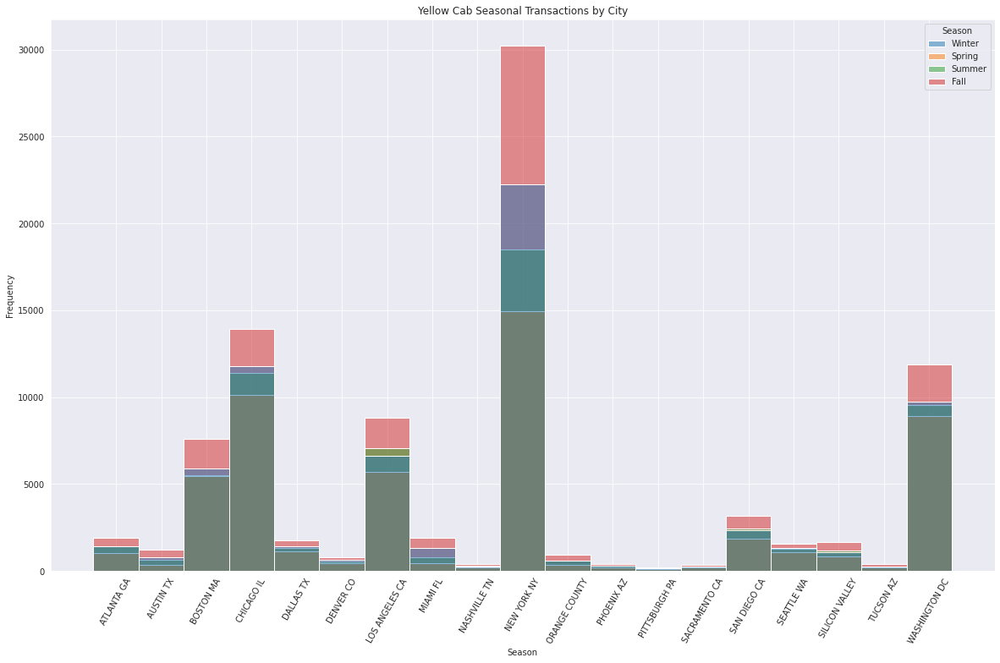

In [77]:
#Yellow Cab Plot
plt.figure(figsize=(20,12))
sns.histplot(data=master_df[master_df.Company=='Yellow Cab'], x='City', hue='Season')
plt.title('Yellow Cab Seasonal Transactions by City')
plt.xlabel('Season')
plt.xticks(rotation = 60)
plt.ylabel('Frequency')

For Pink Cab Company, L.A has the highest sale which is during fall while Yellow Cab Company is New York,<br> <h2>Hypothesis 2: Does with higher card payment method get more customers?</h2>

### Payment Analysis:

In [78]:
#Let's take a look at the percentages of customers that pay with card or cash
fig= px.sunburst(master_df, values='Transaction_ID', path=['Payment_Mode', 'City'], title='Payment Chart')
fig.update_traces(textinfo="label+percent parent")
fig.show()
#px.set_title('Payment Chart')

Text(0, 0.5, 'Frequency')

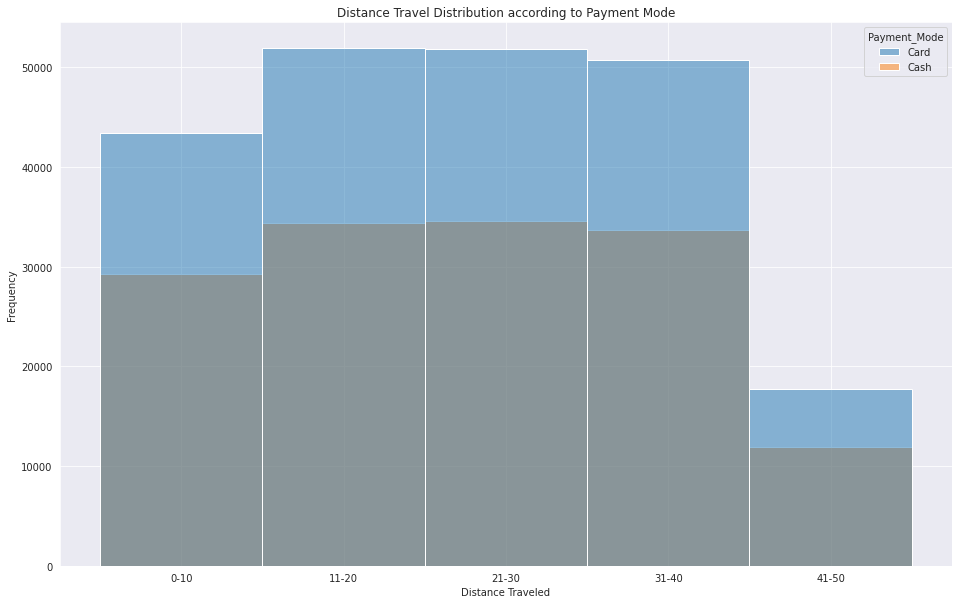

In [79]:
#let's take a look at which customers that pay with card more long distance or short distance
#bin distance travelled
bins = [0, 10, 20, 30, 40, 50]
labels = ['0-10', '11-20', '21-30', '31-40', '41-50']
distance=pd.DataFrame()
distance['binned'] = pd.cut(master_df['KM_Travelled'], bins=bins, labels=labels)
distance[['KM_Travelled', 'Payment_Mode']]=master_df[['KM_Travelled', 'Payment_Mode']]
#plot graph
plt.figure(figsize=(16,10))
sns.histplot(data=distance, x='binned', hue='Payment_Mode')
plt.title('Distance Travel Distribution according to Payment Mode')
plt.xlabel('Distance Traveled')
plt.ylabel('Frequency')

In [80]:
#Seperate both company's data
pinkcab_df=master_df[master_df['Company']=='Pink Cab']
yellowcab_df=master_df[master_df.Company=='Yellow Cab']
print(pinkcab_df.shape)
print(yellowcab_df.shape)

(84711, 18)
(274681, 18)


Text(0.5, 1.0, 'Payment Mode For Cab Companies')

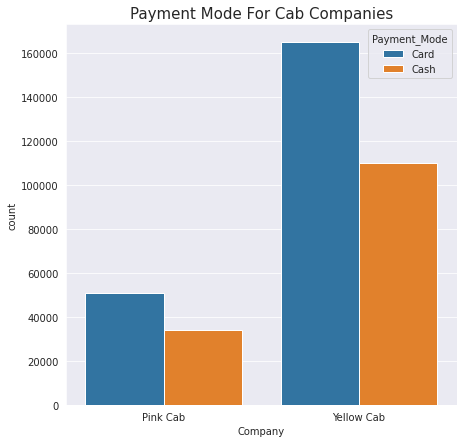

In [81]:
plt.figure(figsize=(7,7))
ax = sns.countplot(x="Company", hue="Payment_Mode", data=master_df)
plt.title('Payment Mode For Cab Companies', fontsize=15)

Yellow cab has higher rate of card users.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



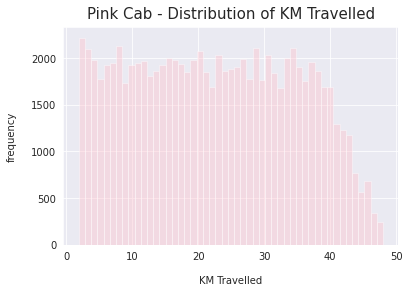

In [82]:
#KM Traveled Distribution
ax = sns.distplot(pinkcab_df['KM_Travelled'], kde=False, color='pink')
plt.title("Pink Cab - Distribution of KM Travelled", fontsize=15, y=1.012)
plt.xlabel("KM Travelled", labelpad=14)
plt.ylabel("frequency", labelpad=14)
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



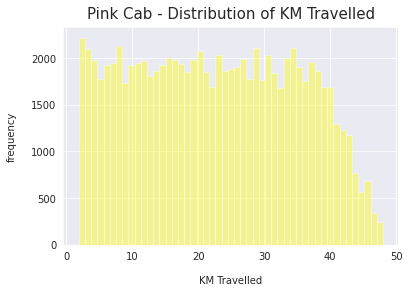

In [83]:
ax = sns.distplot(pinkcab_df['KM_Travelled'], kde=False, color='yellow')
plt.title("Pink Cab - Distribution of KM Travelled", fontsize=15, y=1.012)
plt.xlabel("KM Travelled", labelpad=14)
plt.ylabel("frequency", labelpad=14)
plt.show()

Text(0.5, 1.0, 'KM Travelled by Gender')

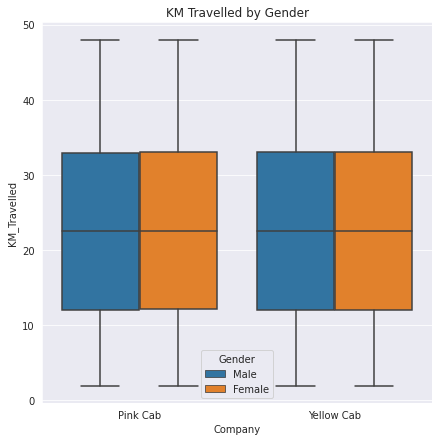

In [84]:
plt.figure(figsize=(7,7))
sns.boxplot(data=master_df, x='Company', y='KM_Travelled', hue='Gender')
plt.title('KM Travelled by Gender')

### User Analysis:

In [85]:
fig = px.pie(master_df, values='Users', names='Company', title='Company Consumer Market Share')
fig.show()

Text(0.5, 0, 'Sex')

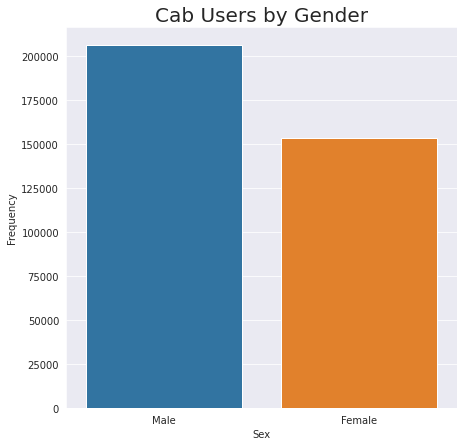

In [86]:
plt.figure(figsize=(7,7))
sns.countplot(data=master_df, x="Gender")
plt.title('Cab Users by Gender', fontsize=20)
plt.ylabel('Frequency')
plt.xlabel('Sex')

Text(0.5, 0, 'Sex')

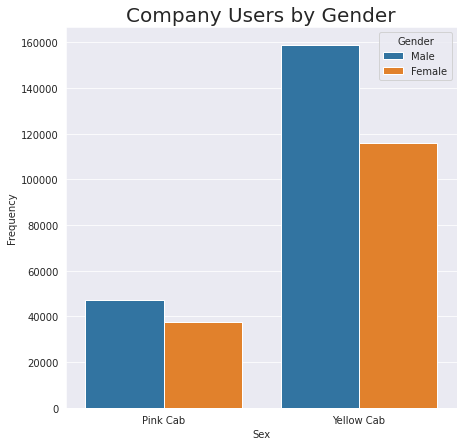

In [87]:
plt.figure(figsize=(7,7))
sns.countplot(data=master_df, x="Company", hue="Gender")
plt.title('Company Users by Gender', fontsize=20)
plt.ylabel('Frequency')
plt.xlabel('Sex')

In [88]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=yellowcab_df.City, values=pinkcab_df.Users, name="Users"),
              1, 1)
fig.add_trace(go.Pie(labels=yellowcab_df.City, values=pinkcab_df.Transaction_ID, name="Transaction"),
              1, 2)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name", textposition='inside')

fig.update_layout(
    title_text="Yellow Cab User and Transaction Share Per City",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Users', x=0.18, y=0.5, font_size=20, showarrow=False),
                 dict(text='Transaction', x=0.82, y=0.5, font_size=20, showarrow=False)])
fig.show()

In [89]:
#Do the same for Pink Cab
# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=pinkcab_df.City, values=pinkcab_df.Users, name="Users"),
              1, 1)
fig.add_trace(go.Pie(labels=pinkcab_df.City, values=pinkcab_df.Transaction_ID, name="Transaction"),
              1, 2)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name", textposition='inside')

fig.update_layout(
    title_text="Pink Cab User and Transaction Share Per City",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Users', x=0.18, y=0.5, font_size=20, showarrow=False),
                 dict(text='Transaction', x=0.82, y=0.5, font_size=20, showarrow=False)])
fig.show()

### Cost and Profit Analysis:

In [90]:
master_df['profit']=master_df['Price_Charged']-master_df['Cost_of_Trip']
master_df.head()

,Transaction_ID,Company,City,KM_Travelled,Price_Charged,Cost_of_Trip,travel_date_,Customer_ID,Gender,Age,Income_(USD/Month),Payment_Mode,Population,Users,month_year,Year,Month,Season,profit
0,10000011,Pink Cab,ATLANTA GA,30.45,370.95,313.635,2016-01-08,29290,Male,28,10813,Card,814885.0,24701.0,2016-01,2016,1,Winter,57.315
1,10000012,Pink Cab,ATLANTA GA,28.62,358.52,334.854,2016-01-06,27703,Male,27,9237,Card,814885.0,24701.0,2016-01,2016,1,Winter,23.666
2,10000013,Pink Cab,ATLANTA GA,9.04,125.20,97.632,2016-01-02,28712,Male,53,11242,Cash,814885.0,24701.0,2016-01,2016,1,Winter,27.568
3,10000014,Pink Cab,ATLANTA GA,33.17,377.40,351.602,2016-01-07,28020,Male,23,23327,Cash,814885.0,24701.0,2016-01,2016,1,Winter,25.798
4,10000015,Pink Cab,ATLANTA GA,8.73,114.62,97.776,2016-01-03,27182,Male,33,8536,Card,814885.0,24701.0,2016-01,2016,1,Winter,16.844


In [96]:
yearly_profit = master_df.groupby(['Company', 'Year']).profit.sum().to_frame('profit')
yearly_revenue = master_df.groupby(['Company', 'Year'])['Price_Charged'].sum().to_frame('Price')

In [97]:
yearly_revenue['profit%'] =(yearly_profit['profit']*100) /yearly_revenue['Price']
yearly_revenue

Price    profit%
Company    Year                        
Pink Cab   2016   7908479.23  21.666760
           2017   9578629.54  21.231168
           2018   8841142.56  17.646613
Yellow Cab 2016  38481133.18  36.191750
           2017  45818910.04  36.177155
           2018  41553843.97  32.529842

Text(0.5, 1.0, 'Profit % per year')

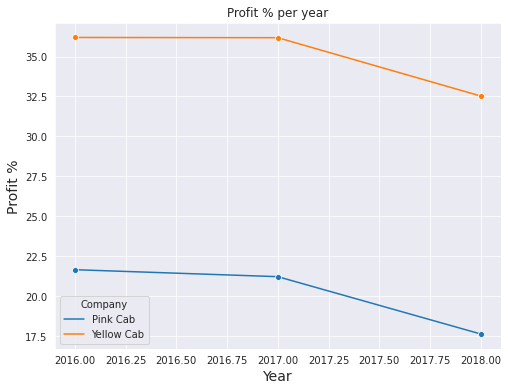

In [100]:
plt.figure(figsize=(8,6))
sns.lineplot(x='Year', y='profit%', hue="Company", data=yearly_revenue, marker='o')
plt.xlabel("Year", size=14)
plt.ylabel("Profit %", size=14)
plt.title("Profit % per year")

Text(0.5, 1.0, 'Prices per year')

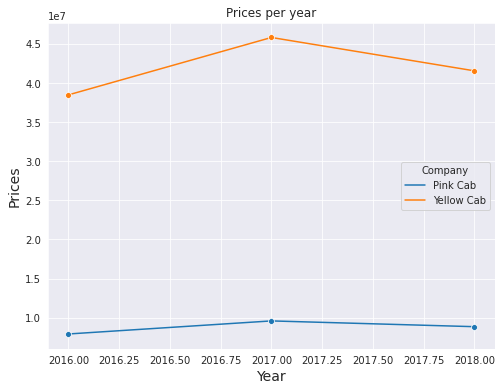

In [101]:
plt.figure(figsize=(8,6))
sns.lineplot(x='Year', y='Price', hue="Company", data=yearly_revenue, marker='o')
plt.xlabel("Year", size=14)
plt.ylabel("Prices", size=14)
plt.title('Prices per year')

In [103]:
#Calculate monthly profit and monthly revenue
monthly_profit = master_df.groupby(['Company', 'Month']).profit.sum().to_frame('profit')
monthly_revenue = master_df.groupby(['Company', 'Month'])['Price_Charged'].sum().to_frame('Price')
#Deduce profit percentage monthly for each cab company
monthly_revenue['profit%'] =(monthly_profit['profit']*100) /monthly_revenue['Price']
monthly_revenue

Price    profit%
Company    Month                        
Pink Cab   1       1638294.62  23.686497
           2       1089685.63  23.129727
           3       1367533.76  21.871239
           4       1257084.99  19.554612
           5       1393308.68  12.101691
           6       1703511.10  13.660917
           7       1932649.58  15.620271
           8       2304272.60  16.849191
           9       2883611.63  17.146391
           10      3312633.47  21.023668
           11      3536883.37  22.910741
           12      3908781.90  26.342059
Yellow Cab 1       8797332.23  38.175616
           2       7412477.30  40.148234
           3       8346839.42  37.753390
           4       8248645.24  37.285430
           5       9546900.53  41.726040
           6       9185653.68  38.977503
           7       9178862.64  31.175558
           8       9881988.88  28.903806
           9      12213217.31  33.917209
           10     13249509.74  32.080521
           11     14056306.30  32.791839
           12     15736153.92  32.887775

Text(0.5, 1.0, 'Prices per Month')

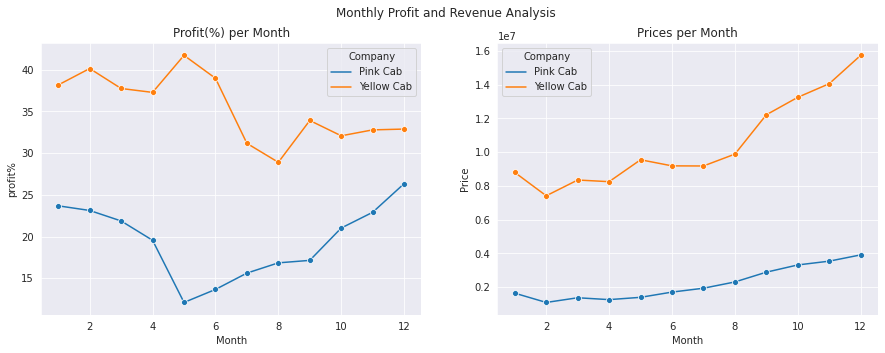

In [114]:
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
sns.set_style("darkgrid")
fig.suptitle('Monthly Profit and Revenue Analysis')
sns.lineplot(ax=axes[0], x='Month', y='profit%', hue="Company", data=monthly_revenue, marker='o')
axes[0].set_title("Profit(%) per Month")
#plot for monthly revenue
sns.lineplot(ax=axes[1], x='Month', y='Price', hue="Company", data=monthly_revenue, marker='o')
axes[1].set_title('Prices per Month')

In [115]:
round(master_df.groupby(['Company']).profit.sum().to_frame('Total Profit'),0)

,Total Profit
Company,
Pink Cab,5307328.0
Yellow Cab,44020373.0


Yellow Cab generates profit by almost 400% more than Pink Cab